In [5]:
# import libraries
import pandas as pd
import geopandas as gpd

# to give more power to your figures (plots)
import matplotlib.pyplot as plt

import contextily as ctx

# for interactive plots, similar to geopands (your choice between folium vs plotly)
import plotly.express as px

# to import open data - in order to use the API links in some of the gov websites
from sodapy import Socrata

import requests

# LA Traffic Collisions in 2020 Overview
We're going to take a look at where all of the traffic incidents reported to the police in 2020 occurred in Los Angeles. This particular year, 42,382 accidents were reported. Overall, we can see that there is just a bit too much data to make sense of any patterns and trends. In the following sections we'll dig a bit deeper. 


In [6]:
#Let's use CSV for data import in order to increase data input to 43k, instead of API limit of 1000. 
tcd = pd.read_csv('Traffic_Collisions_2020.csv')

#lets fix the spaces in the variable names 
tcd.rename(columns={'old column name with spaces': 'new_column_name',
                    'Victim Age' : 'victim_age',
                    'Victim Sex' : 'victim_sex',
                    'Victim Descent' : 'victim_descent'
                   }, inplace=True)

In [7]:
tracts = gpd.read_file('Census_Tracts_2020.geojson')

In [8]:
# convert tcd df to gdf
# since data is in lat/lon's assign the crs to WGS84 (epsg:4326)
gtcd = gpd.GeoDataFrame(tcd, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(tcd.Longitude, tcd.Latitude))

# output the data's projection
gtcd.crs

#calculate the bounding box we're starting with
bbox = gtcd.total_bounds

In [7]:
#calculate the bounding box for LA City - change to our data frame? Use these numbers to clip, and cut out that outlier data piece. 
bbox = tracts.total_bounds

#print the bounding box
print("Bounding Box:")
print("min Longitude:", bbox[0])
print("min Latitude:", bbox[1])
print("max Longitude:", bbox[2])
print("max Latitude:", bbox[3])

Bounding Box:
min Longitude: -118.94519230312248
min Latitude: 32.75004470004891
max Longitude: -117.64638610517382
max Latitude: 34.823306968227755


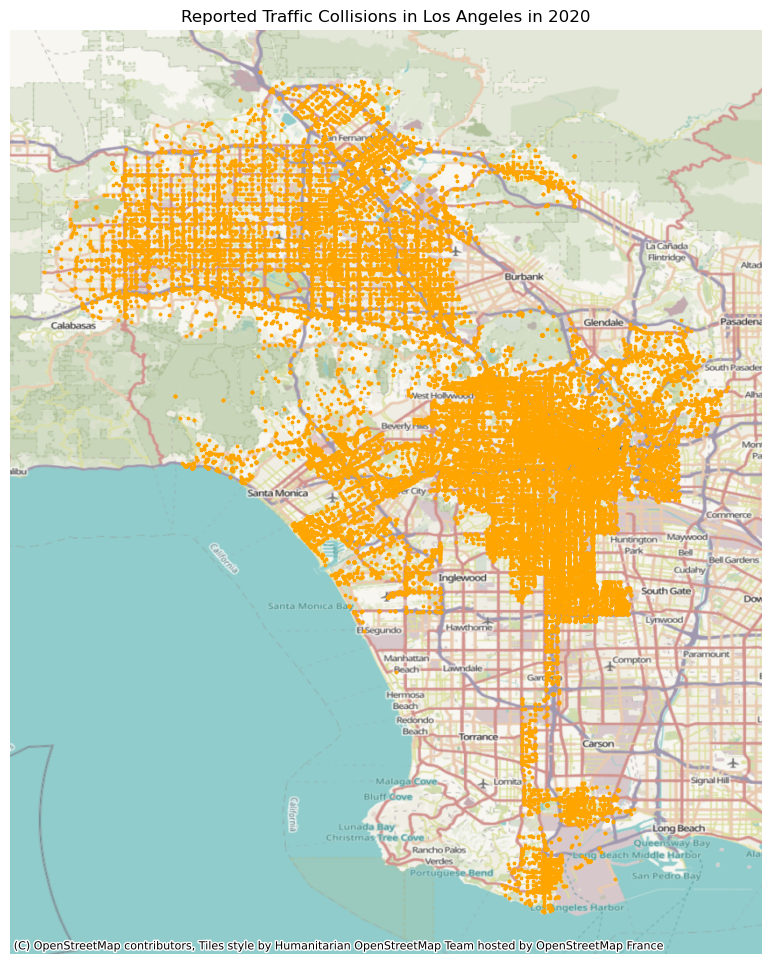

In [8]:
# start the plot (this code doesn't work here) 
fig, ax = plt.subplots(figsize=(12,12)) # figure size is size of axes lengith 12, creating an empty plot. 

# add the data options - cliping the bounds to meet the bounds of USA on map (total bounds of usa)
ax = gtcd.clip([-119,33,-118,35]).plot(ax=ax, # our empty plot is now being set to gdf which has all the data in it. 
        marker='o', #what is the marker we want to use for every xy point (literally an x)
        markersize= 3, #font size of the point
        color='orange') # color of the marker

# turn the axes off
ax.axis('off') #

# give it a title
ax.set_title('Reported Traffic Collisions in Los Angeles in 2020')

# add a basemap - add this to the plot above, and that projected in the same system as above
ctx.add_basemap(ax, crs=4326) # note that we must specify the projection here (crs)

# Exploring demographics of persons invovled in Traffic Collisions during 2020

In [9]:
vsex = getattr(tcd,'victim_sex').unique().tolist()
print(vsex)
# Key/Meta data information
# Victim's Sex: NaN, X, H are all missing values.

['F', 'M', nan, 'X', 'H']


### Victim Sex

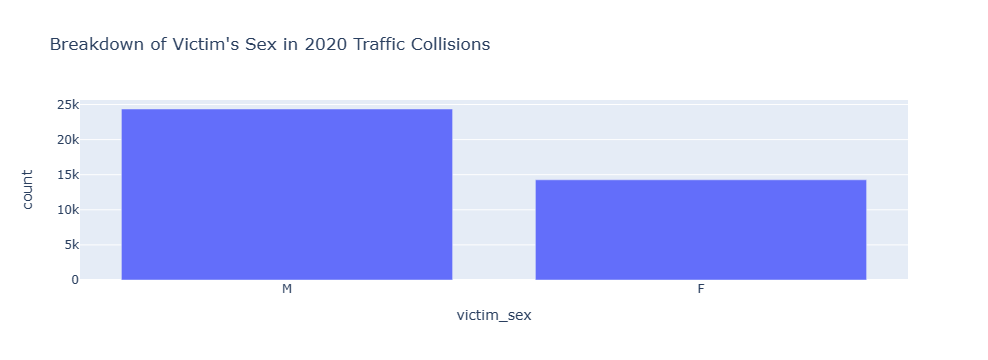

In [10]:
sex_count = tcd.value_counts('victim_sex').reset_index(name = 'count')

# Remove observations containing 'H' and 'X'
sex_count_filtered = sex_count[(sex_count['victim_sex'] != 'X') & (sex_count['victim_sex'] != 'H')]

# plot the info
fig = px.bar(sex_count_filtered,
    x='victim_sex',
    y='count', 
    title = "Breakdown of Victim's Sex in 2020 Traffic Collisions")
fig.show()

In [12]:
sex_count_filtered

,victim_sex,count
0,M,24362
1,F,14274


Men had a significantly higher victim count than women with regards to being involved in an accident. 

**Male Count = 24,62**
**Female Count = 14,274** 


### Victim Descent 

In [13]:
vdescent_count = tcd.value_counts('victim_descent').reset_index(name = 'count')
vdescent_count

,victim_descent,count
0,H,17238
1,W,7823
2,B,6227
3,O,4796
4,X,3542
5,A,1210
6,K,249
7,F,133
8,C,72
9,J,28


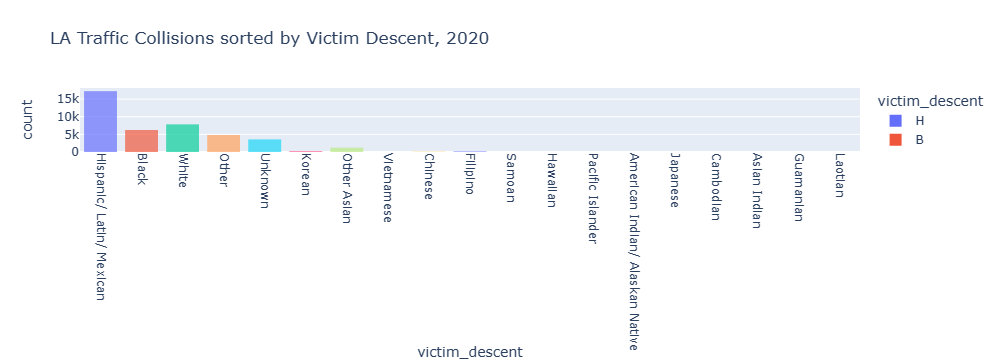

In [15]:
vdescent = getattr(tcd,'victim_descent').unique().tolist()

#add labels by providing a dict
fig = px.bar(
        tcd,
        x='victim_descent',
        color = 'victim_descent',
        title='LA Traffic Collisions sorted by Victim Descent, 2020'
)

# Specify the new labels
new_labels = {
            'A' : 'Other Asian',
            'B' : 'Black',
            'C' : 'Chinese',
            'D' : 'Cambodian',
            'F' : 'Filipino',
            'G' : 'Guamanian',
            'H' : 'Hispanic/ Latin/ Mexican',
            'I' : 'American Indian/ Alaskan Native',
            'J' : 'Japanese',
            'K' : 'Korean',
            'L' : 'Laotian',
            'O' : 'Other',
            'P' : 'Pacific Islander',
            'S' : 'Samoan',
            'U' : 'Hawaiian',
            'V' : 'Vietnamese',
            'W' : 'White',
            'X' : 'Unknown',
            'Z' : 'Asian Indian'  
        }

# Update x-axis labels
#fig.update_xaxes(categoryorder='array', categoryarray=[new_labels.get(cat, cat) for cat in categories])

# get rid of white lines inside the bars
fig.update_traces(marker_line_width=0)

fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = list(new_labels.keys()),
        ticktext = list(new_labels.values())
    )
)
fig.update_xaxes(tickangle=90)

# show the figure
fig.show()

People of Hispanic/Latin/ Mexican descent had the highest count with traffic accidents. 

## Victim Ages

<Axes: title={'center': 'LA Traffic collisions sorted by Victim Age'}, xlabel='age_by_cat'>

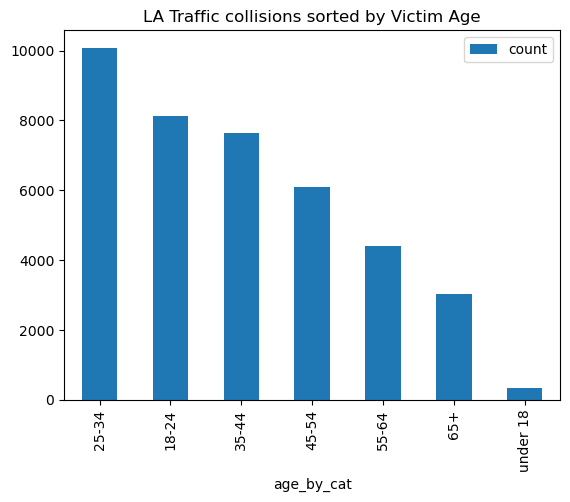

In [19]:
## Collision Victim Ages 
age_raw_count = tcd.value_counts('victim_age').reset_index(name = 'count')

#For Loop to recategorize age: 
age_cat = []
for age in tcd['victim_age']: 
    if pd.isnull(age):  # Check if age is missing
        age_cat.append('NaN')  # Append 'Missing' category
        #missing_count += 1  # Increment missing count
    elif age < 18: 
        age_cat.append('under 18')
    elif 18 <= age <= 24: 
        age_cat.append('18-24')
    elif 25 <= age <= 34:
        age_cat.append('25-34')
    elif 35 <= age <= 44:
        age_cat.append('35-44')
    elif 45 <= age <= 54: 
        age_cat.append('45-54')
    elif 55 <= age <= 64:
        age_cat.append('55-64')
    elif age >= 65:
        age_cat.append('65+')
# add this new variable to the dataframe next
tcd['age_by_cat'] = age_cat

#check to see if added to data frame correctly
# tcd.head(2)

age_count = tcd.value_counts('age_by_cat').reset_index(name = 'count')

# Remove observations containing 'NaN'
age_count_filtered = age_count[(age_count['age_by_cat'] != 'NaN')]

#create a bar graph of the traffic collisions sorted by age
age_count_filtered.plot.bar(x='age_by_cat',
                   y='count',
                   title='LA Traffic collisions sorted by Victim Age')

Drivers between the ages of 25-34 had the highest accident rates in LA City in 2020!

# Interactive Maps

### Overview of Traffic Collision Locations

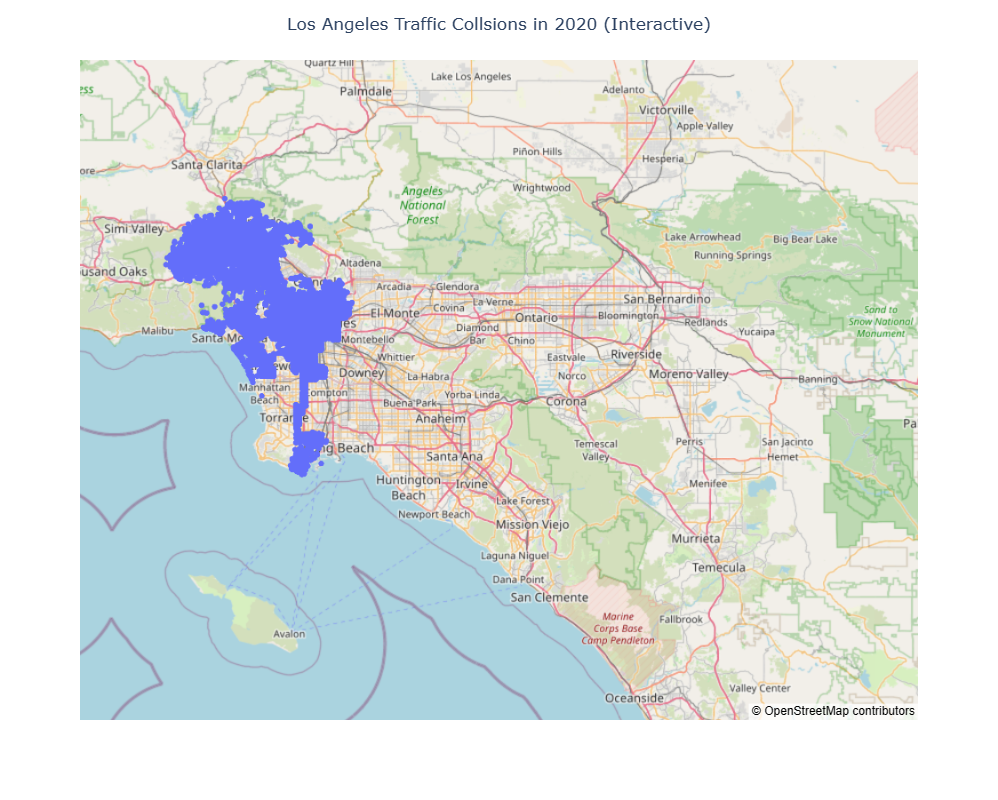

In [20]:
fig = px.scatter_mapbox(tcd, #can change style, similar to contextly's maps. 
                        lat='Latitude',
                        lon='Longitude',
                        mapbox_style="open-street-map")

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Los Angeles Traffic Collsions in 2020 (Interactive)",
    title_x=0.5 # aligns title to center
)

fig.show()

### Mapping Accidents by Location and Sex (2020) 

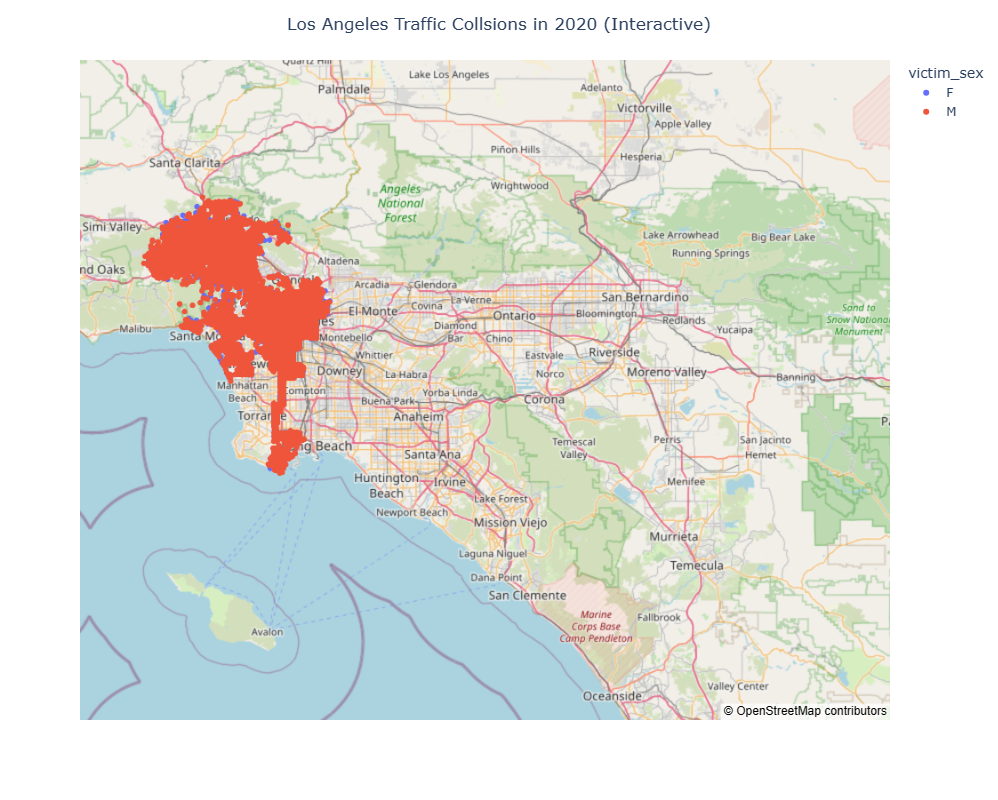

In [21]:
# Remove observations with 'victim_sex' equal to 'X' or 'H'
filtered_sex = tcd[(tcd['victim_sex'] != 'X') & (tcd['victim_sex'] != 'H')]

fig = px.scatter_mapbox(filtered_sex, 
                        lat='Latitude',
                        lon='Longitude',
                        color='victim_sex',
                        mapbox_style="open-street-map")

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Los Angeles Traffic Collsions in 2020 (Interactive)",
    title_x=0.5 # aligns title to center
)

fig.show()

### Mapping Accidents by Location and Age (2020)

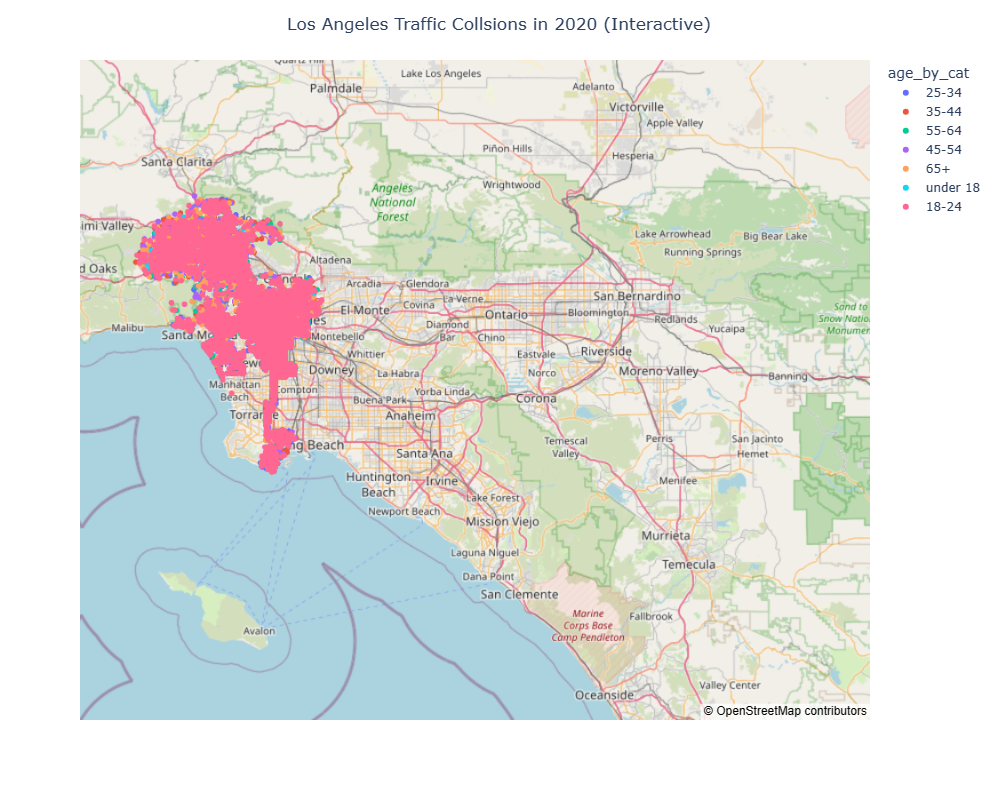

In [22]:
#dropping the nan values in order to display better on map
df_age_cleaned = tcd[tcd['age_by_cat'] != 'NaN']
df_age_cleaned.age_by_cat.unique().tolist()

#create plot
fig = px.scatter_mapbox(df_age_cleaned,
                        lat='Latitude',
                        lon='Longitude',
                        color='age_by_cat',
                        mapbox_style="open-street-map")

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Los Angeles Traffic Collsions in 2020 (Interactive)",
    title_x=0.5 # aligns title to center
)

fig.show()

### Mapping Accidents by Location and Race (2020)

In [37]:
def race_map(race='H'):
    
    fig = px.scatter_mapbox(
                            tcd[tcd.victim_descent==race], 
                            lat="Latitude", 
                            lon="Longitude", 
                            color="victim_descent",
                            labels={'victim_descent':'Race'},
                            mapbox_style="carto-positron"
    )

    # options on the layout
    fig.update_layout(
        width = 600,
        height = 600,
        title = "2020 Interactive Traffic Collisions Map <br>Showing where descent label is "+race,
        title_x=0.5 # aligns title to center
    )

    fig.show()

# get a list of distinct race values
race_list = tcd.victim_descent.unique().tolist()
#remove nan value - its preventing for loop working later. 
race_list_clean = [x for x in race_list if not pd.isnull(x)]
print(race_list_clean)

['H', 'B', 'W', 'O', 'X', 'K', 'A', 'V', 'C', 'F', 'S', 'U', 'P', 'I', 'J', 'D', 'Z', 'G', 'L']


In [1]:
# loop and map!
#for race in race_list_clean:
#    race_map(race)

In [ ]:
Whoo! that was a lot! 

# Part II: Spatial Autocorrelations

In [9]:
# to illustrate, bring in tracts
gdf_tracts = gpd.read_file('tracts-Copy1.geojson')

# population block group data from census reporter
# gdf_bg = gpd.read_file('data/acs2019_5yr_B01003_15000US060372672002.geojson')
gdf_bg = gpd.read_file('acs2021_5yr_B01003_15000US060371041082-Copy1.geojson')

<Axes: >

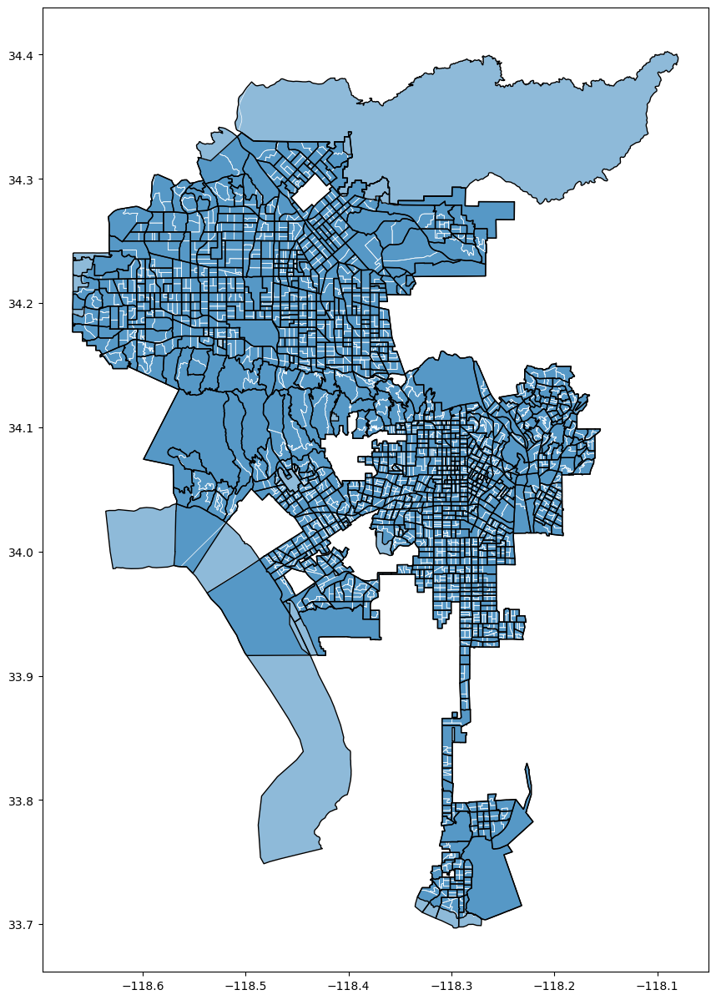

In [10]:
# compare
fig,ax = plt.subplots(figsize=(15,15))

# blue background of census tracts
gdf_tracts.plot(ax=ax,zorder=10,alpha=0.5)

# while lines to show block groups (sandwiched between the two layers above for visual clarity)
gdf_bg.boundary.plot(ax=ax,color='white',zorder=15,lw=0.5) #just boundary of geojson, put boundary before plot.zorder is above

# black boundary lines of census tracts on top of everything
gdf_tracts.boundary.plot(ax=ax,color='black',zorder=20,lw=1)

In [11]:
# what does our data look like? geodata frame block groups
gdf_bg.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2685 entries, 0 to 2684
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   geoid             2685 non-null   object  
 1   name              2685 non-null   object  
 2   B01003001         2685 non-null   float64 
 3   B01003001, Error  2685 non-null   float64 
 4   geometry          2685 non-null   geometry
dtypes: float64(2), geometry(1), object(2)
memory usage: 105.0+ KB


In [12]:
# trim the data to the bare minimum columns
gdf_bg = gdf_bg[['geoid','B01003001','geometry']]

# rename the columns
gdf_bg.columns = ['FIPS','TotalPop','geometry']

In [13]:
# last rows
gdf_bg.tail()
# see the last value -- its a big number on total pop, its the total population for LA. At the bottom is the summary row. 

,FIPS,TotalPop,geometry
2680,15000US060379800281,0.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
2681,15000US060379800311,1160.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
2682,15000US060379800391,0.0,"MULTIPOLYGON (((-118.36215 34.13903, -118.3612..."
2683,15000US060379902000,0.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
2684,16000US0644000,3902440.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [14]:
# delete last row which is for the entire city of LA
gdf_bg.drop(gdf_bg.tail(1).index,inplace=True)
# go into df, first row of the tail. specificially 2684

In [15]:
# fix FIPS code
gdf_bg['FIPS'] = gdf_bg['FIPS'].str.replace('15000US','')
# gdf_bg.tail()
# replace command is really useful in python

In [16]:
# sort by total pop
gdf_bg.sort_values(by='TotalPop').head(20)

,FIPS,TotalPop,geometry
2683,060379902000,0.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
2682,060379800391,0.0,"MULTIPOLYGON (((-118.36215 34.13903, -118.3612..."
2676,060379800221,0.0,"MULTIPOLYGON (((-118.50266 34.30809, -118.5026..."
2677,060379800231,0.0,"MULTIPOLYGON (((-118.64870 34.23120, -118.6480..."
2247,060372653012,0.0,"MULTIPOLYGON (((-118.44878 34.06862, -118.4486..."
2674,060379800201,0.0,"MULTIPOLYGON (((-118.34414 34.21615, -118.3441..."
2680,060379800281,0.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
2668,060379800091,5.0,"MULTIPOLYGON (((-118.33707 34.14160, -118.3361..."
2679,060379800261,16.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
2670,060379800141,44.0,"MULTIPOLYGON (((-118.26088 33.76850, -118.2602..."


In [17]:
# delete less than 100 population geographies
gdf_bg = gdf_bg[gdf_bg['TotalPop']>100]

# Mapping the census block groups

In [18]:
# get the layers into a web mercator projection
# reproject to web mercator, need to do this before mapping. 
gdf_bg = gdf_bg.to_crs(epsg=3857)

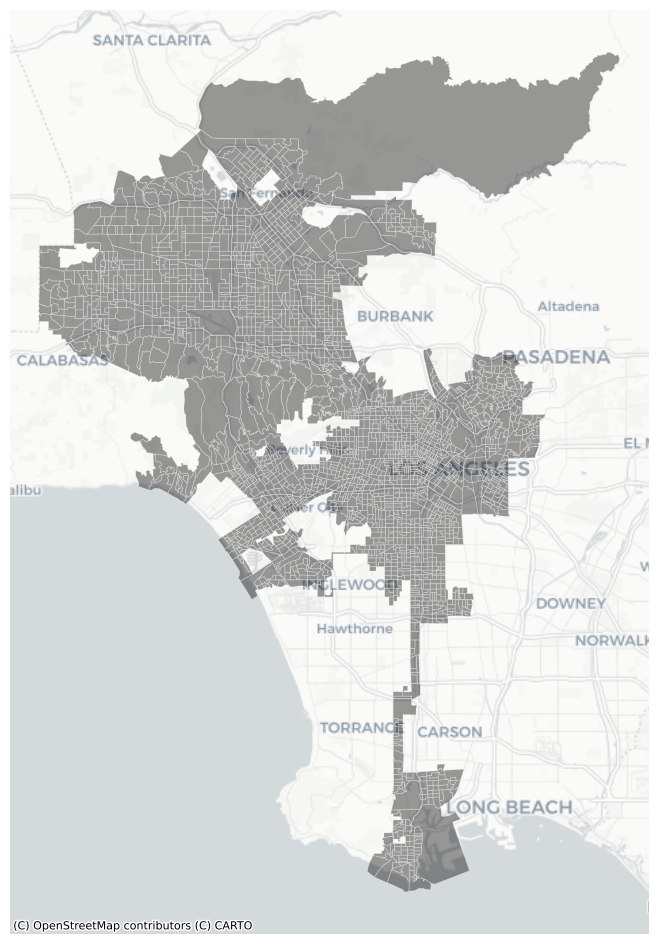

In [19]:
# plot it!
fig, ax = plt.subplots(figsize=(12,12))

gdf_bg.plot(ax=ax,
         color='black', 
         edgecolor='white',
         lw=0.5,
         alpha=0.4)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [20]:
gtcd.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 42382 entries, 0 to 42381
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   DR Number               42382 non-null  int64   
 1   Date Reported           42382 non-null  object  
 2   Date Occurred           42382 non-null  object  
 3   Time Occurred           42382 non-null  int64   
 4   Area ID                 42382 non-null  int64   
 5   Area Name               42382 non-null  object  
 6   Reporting District      42382 non-null  int64   
 7   Crime Code              42382 non-null  int64   
 8   Crime Code Description  42382 non-null  object  
 9   MO Codes                40409 non-null  object  
 10  victim_age              39712 non-null  float64 
 11  victim_sex              41475 non-null  object  
 12  victim_descent          41419 non-null  object  
 13  Premise Code            41540 non-null  float64 
 14  Premise Descri

In [21]:
# get the layers into a web mercator projection
# reproject to web mercator which is a different number than above for epsg
gtcd = gtcd.to_crs(epsg=3857)

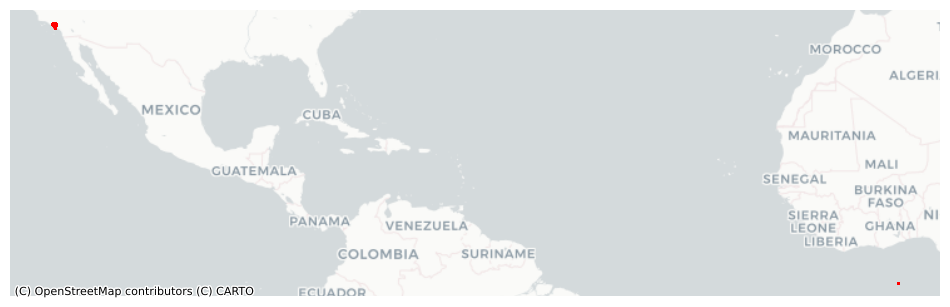

In [22]:
# map it!
fig,ax = plt.subplots(figsize=(12,12))

gtcd.plot(ax=ax,
             color='red',
             markersize=1)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [23]:
# subset the zero coordinate records (but not setting it to the data frame, so not making permanent)
gtcd[gtcd.Longitude==0]

,DR Number,Date Reported,Date Occurred,Time Occurred,Area ID,Area Name,Reporting District,Crime Code,Crime Code Description,MO Codes,victim_age,victim_sex,victim_descent,Premise Code,Premise Description,Address,Cross Street,Latitude,Longitude,geometry
140,201708004,4/7/2020,4/7/2020,1600,17,Devonshire,1728,997,TRAFFIC COLLISION,3004 3036 3025 3101 4026,36.0,F,W,NaN,NaN,00,NaN,0.0,0.0,POINT (0.000 0.000)
143,201708064,4/9/2020,4/9/2020,1550,17,Devonshire,1761,997,TRAFFIC COLLISION,3004 3036 3026 3101 4026,27.0,M,O,NaN,NaN,00,NaN,0.0,0.0,POINT (0.000 0.000)
145,201708086,4/10/2020,4/10/2020,1410,17,Devonshire,1763,997,TRAFFIC COLLISION,3004 3037 3025 3101 4026,24.0,M,H,NaN,NaN,00,NaN,0.0,0.0,POINT (0.000 0.000)
175,202107876,3/31/2020,3/31/2020,1650,21,Topanga,2103,997,TRAFFIC COLLISION,3006 3037 3028 3039 3602 3101 4026,NaN,M,H,NaN,NaN,00,NaN,0.0,0.0,POINT (0.000 0.000)
178,202107902,4/1/2020,4/1/2020,1340,21,Topanga,2173,997,TRAFFIC COLLISION,3004 3036 3026 3101 4026,50.0,F,H,NaN,NaN,00,NaN,0.0,0.0,POINT (0.000 0.000)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41458,202018458,12/16/2020,12/16/2020,1805,20,Olympic,2027,997,TRAFFIC COLLISION,NaN,32.0,M,H,101.0,STREET,6TH ST,CATALINA ST,0.0,0.0,POINT (0.000 0.000)
41528,200717239,12/18/2020,12/18/2020,1115,7,Wilshire,723,997,TRAFFIC COLLISION,NaN,36.0,M,H,101.0,STREET,SWEETZER AV,BEVERLY BL,0.0,0.0,POINT (0.000 0.000)
41629,200918585,12/18/2020,12/18/2020,1000,9,Van Nuys,952,997,TRAFFIC COLLISION,3037 3039 3004 3028 3101 4009,50.0,M,W,101.0,STREET,VAN NUYS BL,MAGNOLIA BL,0.0,0.0,POINT (0.000 0.000)
41687,201226528,9/1/2020,8/30/2020,2000,12,77th Street,1265,997,TRAFFIC COLLISION,NaN,33.0,F,H,101.0,STREET,7900 S VERMONT AV,NaN,0.0,0.0,POINT (0.000 0.000)


In [24]:
# drop the unmapped rows - this is different thant looking at the subset above
gtcd = gtcd[gtcd.Longitude!=0]

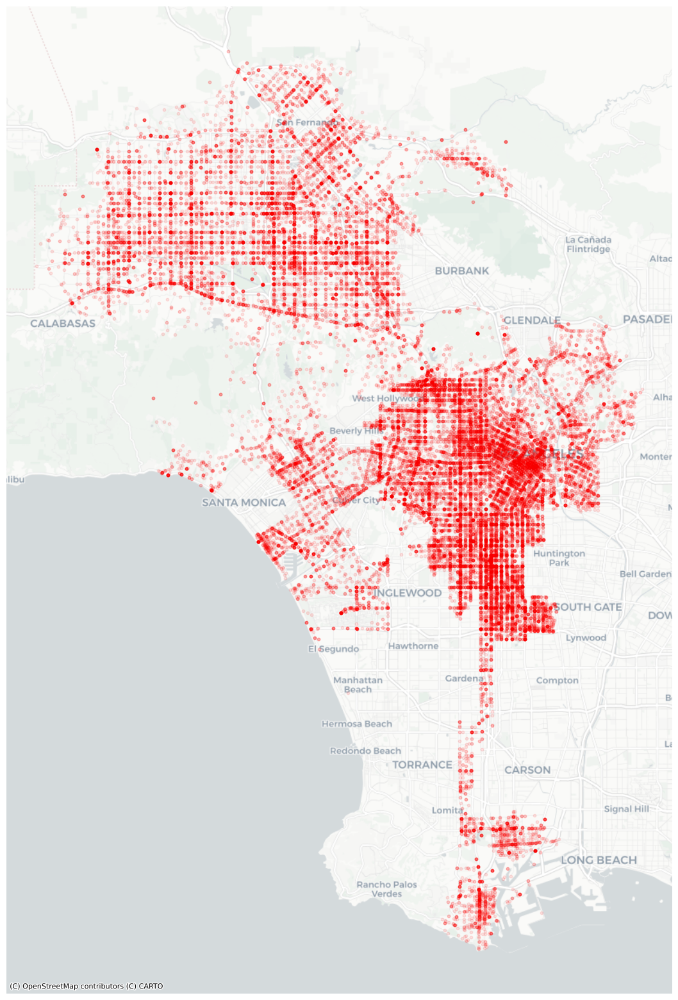

In [25]:
# map it!
fig,ax = plt.subplots(figsize=(20,20))

gtcd.plot(ax=ax,
             color='red',
             markersize=10, alpha=0.1) # 10 percent translucent for alpha

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


# 3.3 Layering Accidents over Block Groups Map

In [26]:
# get the bounding box coordinates for the arrest data
minx, miny, maxx, maxy = gtcd.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-13209872.090321839
-13152998.962475557
3989459.9034047048
4073779.166090612


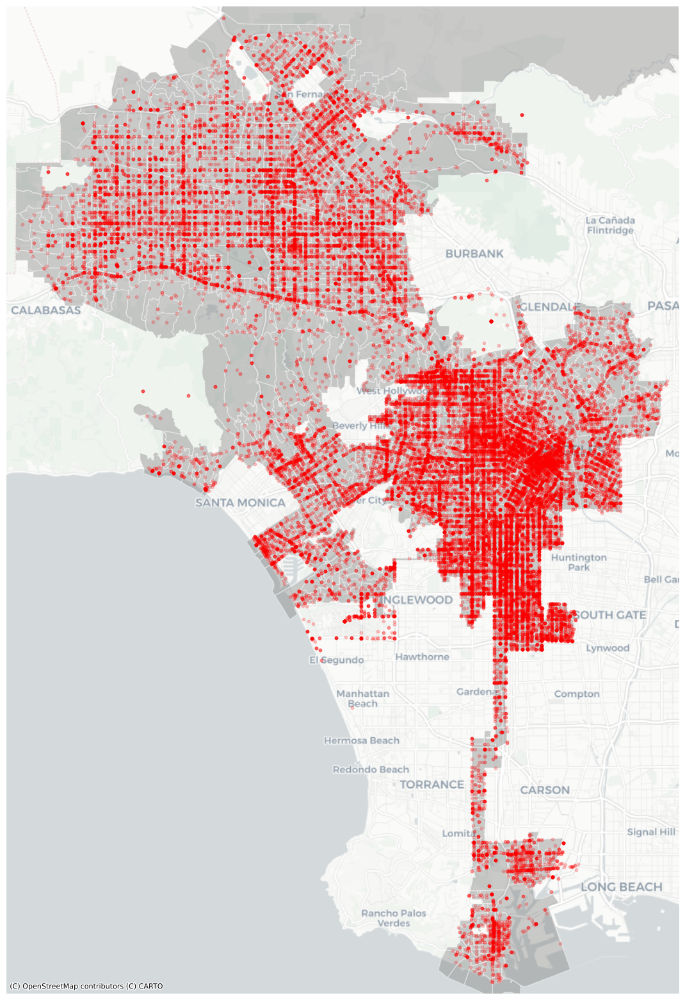

In [27]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(20, 20))

# block groups
gdf_bg.plot(ax=ax, # this puts it in the ax plot
        color='gray', 
        edgecolor='white',
        alpha=0.4)

# arrests
gtcd.plot(ax=ax, # this also puts it in the same ax plot
        color='red',
        markersize=10,
        alpha=0.2)

# use the bounding box coordinates to set the x and y limits
ax.set_xlim(minx - 1000, maxx + 1000) # added/substracted value is to give some margin around total bounds
ax.set_ylim(miny - 1000, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

# Part III: Mapping by Accidents, Race, and Block Groups
Let's Create a map showing the top number of accidents sorted by race, and which block groups had the highest count. 

In [28]:
gtcd.shape

(42166, 20)

In [29]:
# Do the spatial join send df from left
join = gpd.sjoin(gdf_bg, gtcd, how='left')

In [30]:
join.shape

(41441, 23)

In [31]:
gtcd.head(1)

,DR Number,Date Reported,Date Occurred,Time Occurred,Area ID,Area Name,Reporting District,Crime Code,Crime Code Description,MO Codes,victim_age,victim_sex,victim_descent,Premise Code,Premise Description,Address,Cross Street,Latitude,Longitude,geometry
0,200113538,6/17/2020,6/14/2020,2030,1,Central,195,997,TRAFFIC COLLISION,0605 3101 3401 3701 3006 3030 1501,31.0,F,H,101.0,STREET,15TH,MAPLE,34.0326,-118.2589,POINT (-13164520.530 4033180.250)


In [32]:
race_count_by_bg = join.groupby(['FIPS', 'victim_descent']).size().reset_index(name='FIPS by race count')
race_count_by_bg

,FIPS,victim_descent,FIPS by race count
0,060371011101,H,2
1,060371011101,O,1
2,060371011102,H,7
3,060371011102,O,4
4,060371011102,U,1
...,...,...,...
9894,060379800311,G,1
9895,060379800311,H,19
9896,060379800311,O,15
9897,060379800311,W,10


<Axes: title={'center': 'Top 20 Victim Descent by FIPS'}, xlabel='FIPS', ylabel='Count of Accidents by Single Highest Race Contributor'>

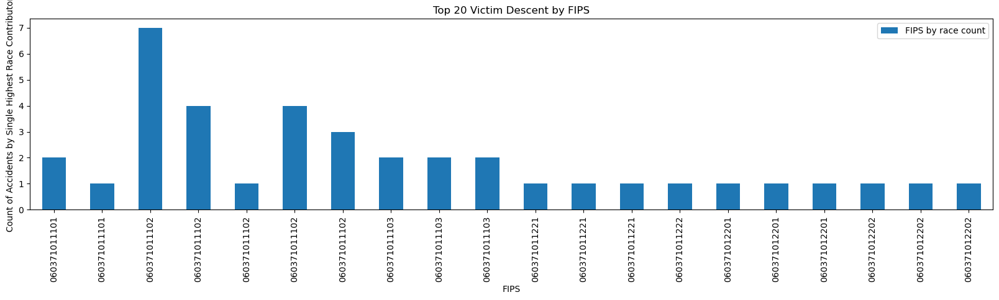

In [33]:
# make a bar chart of top 20 geographies for each FIPs area and breakdown of race
race_count_by_bg[:20].plot.bar(figsize=(20,4),
                             x='FIPS',
                             y='FIPS by race count',
                             title = 'Top 20 Victim Descent by FIPS',
                                ylabel = 'Count of Accidents by Single Highest Race Contributor')

In [34]:
# join the summary table back to the gdf
gdf_bg= gdf_bg.merge(race_count_by_bg,on='FIPS')

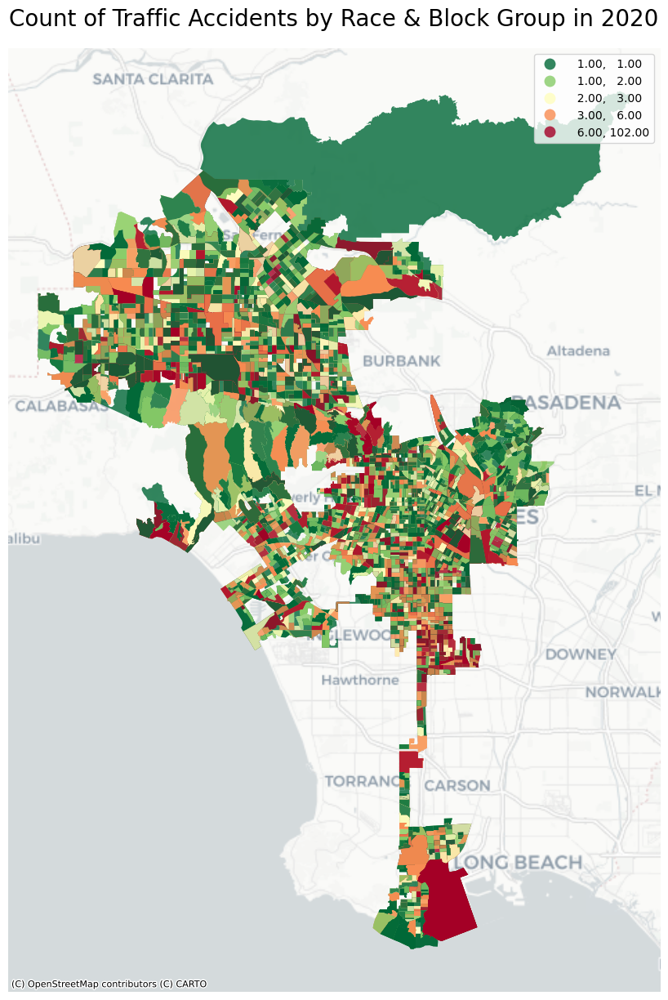

In [35]:
# use subplots that make it easier to create multiple layered maps 
#this map isn't showing much, its actually showing the count of accidents by race & block group. 
# the numbers are low in the legend because its looking at the highest count in that area re: separated by race. 
fig, ax = plt.subplots(figsize=(15, 15))

# spatial lag choropleth
gdf_bg.plot(ax=ax,
         figsize=(15,15),
         column='FIPS by race count',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles')

ax.axis('off')
ax.set_title('Count of Traffic Accidents by Race & Block Group in 2020',fontsize=20,pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [36]:
# our block group table now has a count column
gdf_bg.head(20)

,FIPS,TotalPop,geometry,victim_descent,FIPS by race count
0,060371011101,1630.0,"MULTIPOLYGON (((-13168130.287 4063777.973, -13...",H,2
1,060371011101,1630.0,"MULTIPOLYGON (((-13168130.287 4063777.973, -13...",O,1
2,060371011102,1492.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",H,7
3,060371011102,1492.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",O,4
4,060371011102,1492.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",U,1
5,060371011102,1492.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",W,4
6,060371011102,1492.0,"MULTIPOLYGON (((-13169350.794 4063591.834, -13...",X,3
7,060371011103,757.0,"MULTIPOLYGON (((-13169185.150 4064208.314, -13...",H,2
8,060371011103,757.0,"MULTIPOLYGON (((-13169185.150 4064208.314, -13...",O,2
9,060371011103,757.0,"MULTIPOLYGON (((-13169185.150 4064208.314, -13...",W,2


In [38]:
gdf_bg.sort_values(by="FIPS by race count").tail(20)

,FIPS,TotalPop,geometry,victim_descent,FIPS by race count
7270,060372327021,3236.0,"MULTIPOLYGON (((-13167661.966 4028225.059, -13...",B,43
4633,060371990022,1553.0,"MULTIPOLYGON (((-13161036.898 4039963.506, -13...",H,43
6746,060372240101,1327.0,"MULTIPOLYGON (((-13165691.499 4033647.584, -13...",H,44
7823,060372393101,1389.0,"MULTIPOLYGON (((-13166948.074 4025957.484, -13...",H,45
9888,060379800241,200.0,"MULTIPOLYGON (((-13193418.068 4053521.172, -13...",H,45
7062,060372312202,1858.0,"MULTIPOLYGON (((-13168640.019 4030424.728, -13...",H,45
4973,060372051202,1176.0,"MULTIPOLYGON (((-13160215.471 4031563.603, -13...",H,49
7653,060372376004,711.0,"MULTIPOLYGON (((-13167410.829 4025590.204, -13...",H,49
7236,060372325001,2314.0,"MULTIPOLYGON (((-13170090.289 4027421.623, -13...",B,58
5165,060372074001,2122.0,"MULTIPOLYGON (((-13163883.226 4036698.552, -13...",H,59


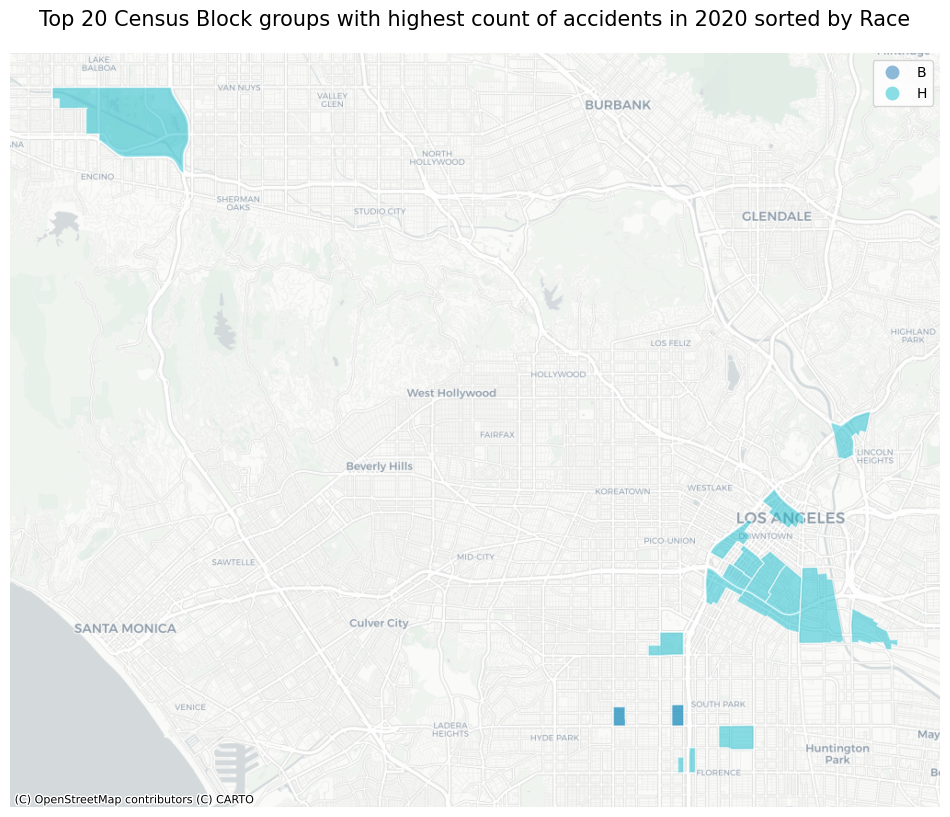

In [40]:
# map the top 20 geographies
fig,ax = plt.subplots(figsize=(12,10))

gdf_bg.sort_values(by='FIPS by race count',ascending=False)[:20].plot(ax=ax, #shows top 20 locations
                                                                column = 'victim_descent', 
                                                                edgecolor='white',
                                                                legend = True, 
                                                                 alpha=0.5)


# title|
ax.set_title('Top 20 Census Block groups with highest count of accidents in 2020 sorted by Race',fontsize=15,pad=20)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)